In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import pathlib
import re

import copy

import numpy as np
import pandas as pd
import xarray as xr
xr.set_options(display_expand_data=False)

from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(context='notebook',palette='bright',style='ticks')

import tqdm

from scipy.stats import norm
from sklearn.cluster import AffinityPropagation

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
%config InlineBackend.figure_formats = ['svg']

In [3]:
from AFL.automation import prepare
from AFL.automation.APIServer import DummyDriver
from AFL.automation.instrument import VirtualSANS_data
from AFL.automation.shared.units import units,is_concentration,is_volume,is_mass
from AFL.agent.AgentClient import AgentClient
from AFL.agent import xarray_extensions, GaussianProcess
from AFL.agent import Metric,PhaseLabeler,AcquisitionFunction
from AFL.automation.APIServer.Client import Client

# Make Mask

## Set up Deck

In [4]:
deck =  prepare.Deck()
deck.mass_cutoff = 1e-2*units('ug')
##connect to the fake server
deck.client = Client(ip='localhost',port=5051)
deck.client.url = f'http://{deck.client.ip}:{deck.client.port}'

deck.client.login('AFL-deck')


deck.send_deck_config()

tipracks=[(3,'opentrons_96_tiprack_300ul'),(5,'opentrons_96_tiprack_300ul')]
deck.add_pipette('p300_single_gen2','left',tipracks=tipracks)

tipracks=[(6,'opentrons_96_tiprack_1000ul'),(9,'opentrons_96_tiprack_1000ul')]
deck.add_pipette('p1000_single_gen2','right',tipracks=tipracks)

deck.add_container('nist_6_20ml_vials',1)
deck.add_container('nist_2_100ml_poly_bottle',2)

deck.add_container('nest_96_wellplate_1600ul',4)
deck.add_container('nest_96_wellplate_1600ul',8)

catch_loc = '10A1'
deck.add_catch ('nist_pneumatic_loader',10)

ConnectionError: HTTPConnectionPool(host='localhost', port=5051): Max retries exceeded with url: /login (Caused by NewConnectionError('<urllib3.connection.HTTPConnection object at 0x2a7cfa1f0>: Failed to establish a new connection: [Errno 61] Connection refused'))

In [ ]:
## this connects to the real server
#deck.init_remote_connection('piot2',home=True)

In [ ]:
deck.make_align_script('align.py')

## Gantry Speed

In [ ]:
deck.client.enqueue(task_name='set_gantry_speed',speed=300,interactive=False)

## Specify Mixing Wells in Wellplates

In [ ]:
w1 = prepare.make_wellplate_locs(slot=4,size=96)
w2 = prepare.make_wellplate_locs(slot=8,size=96)#[63:]]
w = w1 + w2
print(w)
deck.client.enqueue(task_name='add_prep_targets',
             targets=w,
             reset=True,
            )

## Reset Tipracks

In [ ]:
prepare.db.read()

## Make Stocks and Add to Deck

In [ ]:
prepare.db.read()
prepare.db

In [11]:
deck.reset_stocks()

stock_D2O = prepare.Solution('stock_buffer',['D2O'])
stock_D2O.volume = 20*units("ml")
deck.add_stock(stock_D2O,'2A1')

stock_Px = prepare.Solution('stock_Px',['D2O','P188'])
stock_Px.volume = 20*units("ml")
stock_Px.concentration = {'P188':102.83*units('mg/ml')}
deck.add_stock(stock_Px,'1A3')

stock_Bz = prepare.Solution('stock_Bz',['D2O','benzyl_alcohol_solute'])
stock_Bz.volume = 20*units("ml")
stock_Bz.concentration = {'benzyl_alcohol_solute':30.58*units('mg/ml')}
deck.add_stock(stock_Bz,'1A2')

stock_Ph = prepare.Solution('stock_Ph',['D2O','phenol_solute'])
stock_Ph.volume = 20*units("ml")
stock_Ph.concentration = {'phenol_solute':32.61*units('mg/ml')}
deck.add_stock(stock_Ph,'1A1')

In [15]:
from multiprocessing import Process, Pool
import time
def f(num):
    time.sleep(2)
PROCESSES = 4
with Pool(PROCESSES) as pool:
    results = [pool.apply_async(f,num) for num in range(4)]
    for r in results:
        print(r.get())
# p.start()
# while p.is_alive() == True:
#     time.sleep(1)
#     print('process is still running ')

# p.close()
print('finished')

Process SpawnPoolWorker-7:
Traceback (most recent call last):
  File "/Users/drs18/mambaforge/envs/afl/lib/python3.8/multiprocessing/process.py", line 315, in _bootstrap
    self.run()
  File "/Users/drs18/mambaforge/envs/afl/lib/python3.8/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
  File "/Users/drs18/mambaforge/envs/afl/lib/python3.8/multiprocessing/pool.py", line 114, in worker
    task = get()
  File "/Users/drs18/mambaforge/envs/afl/lib/python3.8/multiprocessing/queues.py", line 358, in get
    return _ForkingPickler.loads(res)
AttributeError: Can't get attribute 'f' on <module '__main__' (built-in)>
Process SpawnPoolWorker-8:
Traceback (most recent call last):
  File "/Users/drs18/mambaforge/envs/afl/lib/python3.8/multiprocessing/process.py", line 315, in _bootstrap
    self.run()
  File "/Users/drs18/mambaforge/envs/afl/lib/python3.8/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
  File

KeyboardInterrupt: 

In [12]:
components = ['P188','benzyl_alcohol_solute','phenol_solute','D2O']
AL_components = ['P188','benzyl_alcohol_solute','phenol_solute']
# components = ['P188','benzyl_alcohol_solute','phenol_solute','D2O']
# AL_components = ['benzyl_alcohol_solute','phenol_solute','D2O']
AL_components_grid = [k+'_grid' for k in AL_components]

##### Define Bounds and Mask 

In [13]:
MB = deck.make_mass_balance()
MB.process_components()
samples = MB.sample_composition_space(grid_density=9,pipette_min=20*units('ul'),stock_transfer_max=1*units('ml'),composition_data='conc')
samples1 = MB.constrain_samples_conc(
    {
        'benzyl_alcohol_solute':{'value':13*units('mg/ml'), 'compare':'lt'},
        'phenol_solute':{'value':13*units('mg/ml'), 'compare':'lt'},
    },
    rtol=0.05)

MB.stock_samples.attrs['components'] = AL_components
MB.stock_samples.attrs['P188_range'] = [10.0,10.1]
MB.stock_samples.attrs['benzyl_alcohol_solute_range'] = [1,16]
MB.stock_samples.attrs['phenol_solute_range'] = [1,16]
MB.stock_samples.attrs['P188_npts'] = 1
MB.stock_samples.attrs['benzyl_alcohol_solute_npts'] = 50
MB.stock_samples.attrs['phenol_solute_npts'] = 50
MB.stock_samples.attrs['P188_units'] = 'mg/ml'
MB.stock_samples.attrs['benzyl_alcohol_solute_units'] = 'mg/ml'
MB.stock_samples.attrs['phenol_solute_units'] = 'mg/ml'

  0%|          | 0/65536 [00:00<?, ?it/s]

In [14]:
MB.calculate_bounds(components=AL_components,exclude_comps_below=0.0001,composition_data='samples_conc',ternary=False)

In [15]:
MB.make_grid_mask(pts_per_row=None,ternary=False)
MB.stock_samples = MB.stock_samples.reset_index('grid').reset_coords().set_index(grid='grid_mask').sel(grid=True).reset_index('grid').reset_coords()#.rename({'grid':'mask'})
MB.stock_samples

--> Making grid for components ['P188', 'benzyl_alcohol_solute', 'phenol_solute'] at None pts_per_row


  0%|          | 0/2500 [00:00<?, ?it/s]

<xarray.Dataset>
Dimensions:                     (sample: 40512, component: 4, stock: 4,
                                 sample_valid: 40512, coord: 3, grid: 1595)
Coordinates:
  * component                   (component) <U21 'D2O' ... 'phenol_solute'
  * stock                       (stock) <U12 'stock_buffer' ... 'stock_Ph'
Dimensions without coordinates: sample, sample_valid, coord, grid
Data variables: (12/16)
    samples_frac                (sample, component) float64 0.964 ... 0.00708
    samples_mass                (sample, component) float64 88.8 2.057 ... 32.61
    samples_conc                (sample, component) float64 1.11e+03 ... 8.152
    samples_volume              (sample) float64 0.08 0.09261 ... 3.877 4.0
    stock_mass_transfers        (sample, stock) float64 22.2 24.26 ... 1.143e+03
    D2O                         (sample) float64 1.11e+03 1.11e+03 ... 1.11e+03
    ...                          ...
    xy                          (sample_valid, coord) float64 25.71 ... 8.152
    samples_valid               (sample_valid, component) float64 1.11e+03 .....
    P188_grid                   (grid) float64 10.0 10.0 10.0 ... 10.0 10.0 10.0
    benzyl_alcohol_solute_grid  (grid) float64 1.0 1.0 1.0 ... 12.94 12.94 12.94
    phenol_solute_grid          (grid) float64 1.0 1.306 1.612 ... 11.41 11.71
    grid                        (grid) bool True True True ... True True True
Attributes: (12/16)
    components:                        ['P188', 'benzyl_alcohol_solute', 'phe...
    P188_range:                        [10.0, 10.1]
    benzyl_alcohol_solute_range:       [1, 16]
    phenol_solute_range:               [1, 16]
    P188_npts:                         1
    benzyl_alcohol_solute_npts:        50
    ...                                ...
    hull:                              <scipy.spatial._qhull.ConvexHull objec...
    delaunay:                          <scipy.spatial._qhull.Delaunay object ...
    components_grid:                   ['P188_grid', 'benzyl_alcohol_solute_g...
    P188_grid_range:                   [10.0, 10.1]
    benzyl_alcohol_solute_grid_range:  [1, 16]
    phenol_solute_grid_range:          [1, 16]

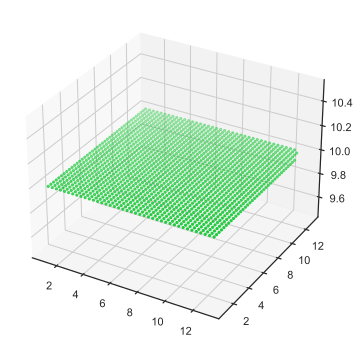

In [16]:
# %matplotlib tk
fig = plt.figure(figsize=(6,6))
ax = fig.add_subplot(projection='3d')

grid_data = MB.stock_samples[['P188_grid','benzyl_alcohol_solute_grid','phenol_solute_grid','D2O']]
# mask = np.zeros_like(grid_data.P188_grid,dtype=bool)
# for z in np.linspace(2,50,25):
#     mask = np.logical_or(mask,np.isclose(grid_data.P188_grid,z,rtol=0.1))

    
# grid_data = grid_data.where(grid_data.P188_grid.copy(data=mask),drop=True)
z = grid_data.P188_grid
x = grid_data.benzyl_alcohol_solute_grid
y = grid_data.phenol_solute_grid
ax.scatter(xs=x,ys=y,zs=z,color='g',marker='.')

In [17]:
grid_mask = MB.stock_samples[['grid']+AL_components_grid]
grid_mask.attrs.update(MB.stock_samples.attrs)
grid_mask = grid_mask.rename_vars(grid='mask')
# grid_mask = grid_mask.reset_index('grid').reset_coords()
grid_mask.P188_grid.max()


<xarray.DataArray 'P188_grid' ()>
10.0

In [18]:
AL_kwargs = copy.copy(MB.stock_samples.attrs)
del AL_kwargs['hull']
del AL_kwargs['delaunay']


AL_kwargs['GP_domain_transform'] = 'range_scaled'

AL_kwargs['AL_regression_data'] = 'turbidity'
AL_kwargs['AL_mode'] = 'bimodal_UCB'
AL_kwargs['regression_mode'] = 'homoscedastic'
AL_kwargs['savgol_filter'] = 'SAS'
AL_kwargs['SAS_savgol_xname'] = 'q'
AL_kwargs['SAS_savgol_yname'] = 'SAS'
AL_kwargs['SAS_savgol_xlo'] = 0.01
AL_kwargs['SAS_savgol_xhi'] = 0.25
AL_kwargs['SAS_savgol_pedestal'] = 1e-12
AL_kwargs['SAS_savgol_npts'] = 250
AL_kwargs['SAS_savgol_window_length']= 31
AL_kwargs['SAS_savgol_polyorder']= 2
AL_kwargs['SAS_savgol_logx']= int(True)
AL_kwargs['SAS_savgol_logy']= int(True)
AL_kwargs

{'components': ['P188', 'benzyl_alcohol_solute', 'phenol_solute'],
 'P188_range': [10.0, 10.1],
 'benzyl_alcohol_solute_range': [1, 16],
 'phenol_solute_range': [1, 16],
 'P188_npts': 1,
 'benzyl_alcohol_solute_npts': 50,
 'phenol_solute_npts': 50,
 'P188_units': 'mg/ml',
 'benzyl_alcohol_solute_units': 'mg/ml',
 'phenol_solute_units': 'mg/ml',
 'components_grid': ['P188_grid',
  'benzyl_alcohol_solute_grid',
  'phenol_solute_grid'],
 'P188_grid_range': [10.0, 10.1],
 'benzyl_alcohol_solute_grid_range': [1, 16],
 'phenol_solute_grid_range': [1, 16],
 'GP_domain_transform': 'range_scaled',
 'AL_regression_data': 'turbidity',
 'AL_mode': 'bimodal_UCB',
 'regression_mode': 'homoscedastic',
 'savgol_filter': 'SAS',
 'SAS_savgol_xname': 'q',
 'SAS_savgol_yname': 'SAS',
 'SAS_savgol_xlo': 0.01,
 'SAS_savgol_xhi': 0.25,
 'SAS_savgol_pedestal': 1e-12,
 'SAS_savgol_npts': 250,
 'SAS_savgol_window_length': 31,
 'SAS_savgol_polyorder': 2,
 'SAS_savgol_logx': 1,
 'SAS_savgol_logy': 1}

# Setup Agent Server

In [130]:
#this needs to be re-written for my purposes. The virtual SANS Driver in AFL-agent talks to a ton of servers. 
#need to call a virtualAgent with communication to the loader, the OT2, the SampleServer and the SANS data producer
agent_client = AgentClient('localhost',5057)
agent_client.login('test')
agent_client.pause(False)

In [18]:
import datetime
data_tag = f'Virtual_AL_multi-modal_test_13-13-10_random_{datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%S")}'

agent_client.set_config(
    data_path='/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/',
    save_path='/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/',
    AL_manifest_file=f'/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/231125_VirtualAL_pEI_manifest-{data_tag}.nc',
    data_tag=data_tag,
    qlo = 0.0125,
    qhi = 0.25,
    subtract_background=False
)

# set the config file for data blending?

#for random sample
agent_client.set_driver_object(sample_randomly=True)


# acquisition function design:
# for the split data can have independent tasks. so in theory there could be two separate agents running, what could be augmented is the space in which things are allowed to be evalluated...
# would rather have the one that is knowledgeable about both and an acquisition policy that operates on both the GPs at the same time
# If running independently they will not directly talk to one another, except through the down selection? 
## a joint acquisition function would maybe produce a worse measurement for both data sets if the space isn't bounded well enough yet. SO
### we could put 3 agent clients on the board and only kick the 3rd one on when the two independent ones have satisfied some amount... weak influence vs. strong influence
from AFL.agent import UCB_AcquisitionFunction, EI_AcquisitionFunction
# acq = EI_AcquisitionFunction.EI()
acq = EI_AcquisitionFunction.pseudoEI(Thompson_sampling=True)

acq.composition_atol = 0.05
acq.metric_rtol = 0.15

# if there are different tasks for each of the SAS decision making agents then specify them and let them communicate 
agent_client.set_driver_object(acquisition=acq)

# this is ultimately the thing that gets passed back and forth between each of the SAS agents as the weak influencer, do this synchronously and have the third GP keep updating the mask/grid_mask but don't call or pull it 
# until the individual agents are ready to evaluate.
agent_client.set_driver_object(mask=grid_mask)

# the strong influencer comes in when we have decided to turn it on or do the joint optimization.


NameError: name 'agent_client' is not defined

In [132]:
# agent_client.get_config('all',interactive=True)
mask = agent_client.get_driver_object('mask')
mask['phenol_solute_grid'].max()

<xarray.DataArray 'phenol_solute_grid' ()>
12.94

In [95]:
agent_client.get_driver_object('sample_randomly')

True

# Check Agent Calculations

It is necessary to run the agent client through one cycle before starting the AL

In [23]:
#agent_client.enqueue(task_name='read_data',interactive=True)
#agent_client.enqueue(task_name='label',interactive=False)
#agent_client.enqueue(task_name='extrapolate',interactive=False)
# agent_client.enqueue(task_name='get_next_sample',interactive=True)
agent_client.enqueue(task_name='predict',datatype='nc',interactive=False)

UUID('eede3dca-f78d-4438-a9ab-cb2b1545f7dd')

In [25]:
ds = agent_client.get_driver_object('next_sample')
#ls = agent_client.get_object('labeler')
# acq = agent_client.get_object('acquisition')
# ns = agent_client.get_object('next_sample')
# print('n_phases=',ds.attrs['n_phases'])

None

# Setup SAS data driver

In [24]:
sas_url = 'localhost:5054'
sas_client = Client(sas_url.split(':')[0],port=sas_url.split(':')[1])
sas_client.login('SampleServer_SASClient')
sas_client.debug(False)
sas_client.set_config(
    filepath='/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/',
    save_path='/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/'
)

netcdf_path = '/Users/drs18/Documents/multimodal-dev/phasemap_P188_2D_MultiModal_UCB_noThomp_FixedP188_30524b88-00f7-4606-9c4d-57ad7880f95e.nc'
# ds_manifest_path = 'phasemap_P188_2D_MultiModal_UCB_noThomp_FixedP188_30524b88-00f7-4606-9c4d-57ad7880f95e.nc'

model_ds = xr.load_dataset(netcdf_path)
sas_client.set_driver_object(dataset=model_ds)
sas_client.set_driver_object(clustered=True)

# query = catalogue.search(Eq('task_name', 'expose'))
# entries = list(query.items())
# for idx, (key, value) in enumerate(query.items()):
#     print(idx, value.metadata)
    
# key,value = query.items()[-1]
# value.metadata
# print('params_dict = ',params_dict)

# params_dict['X_data_exclude'] = []
# sas_client.enqueue(task_name='set_defaults', device='sg', default_dict=defaults)
# sas_client.enqueue(task_name='load_model_dataset')
# sas_client.enqueue(task_name='get_params_dict')
# sas_client.enqueue(task_name='generate_model')
# sas_client.enqueue(task_name='train_model',niter=101)

<Response [200]>

In [25]:
sas_client.enqueue(task_name='load_model_dataset')
# sas_client.enqueue(task_name='get_defaults',device='sg')
params_dict_uuid = sas_client.enqueue(task_name='get_params_dict',interactive=True)
params_dict = sas_client.get_driver_object('params_dict')
params_dict['X_data_exclude'] = []
print('params_dict = ',params_dict)
sas_client.enqueue(task_name='set_params_dict', params_dict=params_dict)
sas_client.enqueue(task_name='generate_model')
sas_client.enqueue(task_name='train_model',niter=101)

params_dict =  {'X_data_pointer': 'components', 'X_data_exclude': [], 'Y_data_filter': ('SAS_savgol_xlo', 'SAS_savgol_xhi'), 'Y_data_pointer': 'SAS', 'Y_data_coord': 'q'}


UUID('8f7b6f6d-279e-4ed3-b225-1aededceb317')

## Test the server

In [26]:
new_data = {
    'sample_composition':{
        'P188':{
            'values':[10.],
            'units':'mg/ml'
        },
        'benzyl_alcohol_solute':{
            'values':[5.7],
            'units': 'mg/ml'
        },
        'phenol_solute':{
            'values':[7.4],
            'units': 'mg/ml'
        },
    }
}
sas_client.enqueue(task_name='set_sample',sample_name='test',**new_data)
sas_client.enqueue(task_name='expose')
from tiled.client import from_uri
from tiled.queries import Eq
tc = from_uri('http://localhost:8000',api_key='NistoRoboto642')
query = tc.search(Eq('task_name','expose'))
key, value = query.items()[-1]
print(key, value)
print(np.array(value))

3aeea498-c18b-42a6-9de1-6ef58b4a7b15 <ArrayClient shape=(444,) chunks=((444,),) dtype=float64>
[893.07422499 890.54799515 885.08071444 875.41035599 864.36446873
 859.81334931 854.5533514  850.63315756 846.11749364 838.30969155
 829.74599624 823.72372291 814.02589973 808.21612233 798.99769527
 792.63453723 786.29456891 774.09170649 762.06446075 750.29975777
 744.15444842 734.90909327 721.7076024  710.32346533 699.6241672
 692.54528799 685.21138197 669.22871225 652.78489849 635.85366933
 618.09458698 605.65120538 590.09838928 575.7089936  555.44784849
 540.29517443 527.0052629  517.52590368 506.14754648 495.94676346
 477.36751662 463.52684693 452.55556655 441.41513782 426.34389079
 410.3525845  395.74381067 378.81690032 367.44727675 359.60504216
 346.40971581 332.54359223 319.49264883 308.30123913 300.12097912
 293.01458911 279.89549468 269.77998228 260.61303131 253.63681492
 245.16381055 237.07716636 229.45682346 220.73629437 212.40007333
 205.68093636 200.36397435 194.40634123 188.1552

# Setup Turbidity Server

## load the supplemented dataset

<xarray.Dataset>
Dimensions:                (sample: 53)
Coordinates:
  * sample                 (sample) int64 0 1 2 3 4 5 6 ... 46 47 48 49 50 51 52
Data variables:
    benzyl_alcohol_solute  (sample) float64 1.25 4.562 7.875 ... 6.122 5.204
    phenol_solute          (sample) float64 6.5 6.5 6.5 6.5 ... 3.367 3.673 3.98
    P188                   (sample) float64 10.0 10.0 10.0 ... 10.0 10.0 10.0
    turbidity              (sample) float64 0.9448 1.0 0.965 ... 0.8932 0.9192
Attributes: (12/40)
    components:                        ['P188', 'benzyl_alcohol_solute', 'phe...
    P188_range:                        [10.  10.1]
    benzyl_alcohol_solute_range:       [ 0 15]
    phenol_solute_range:               [ 0 15]
    P188_npts:                         1
    benzyl_alcohol_solute_npts:        50
    ...                                ...
    uuid:                              30524b88-00f7-4606-9c4d-57ad7880f95e
    date:                              230530
    time:                              09:05:33
    data_tag:                          P188_2D_MultiModal_UCB_noThomp_FixedP188
    acq_count:                         1
    iteration:                         31

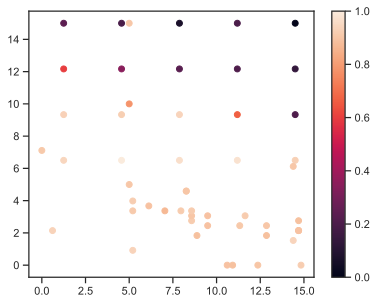

In [145]:
ds_1 = xr.load_dataset('turbidity_data_recollects/supplemental_10-P188_dataset.nc')
turb_recollect = np.genfromtxt('turbidity_data_recollects/2023-10-31_turbidity_values_10-mgml-P188.txt',delimiter=' ')
netcdf_path = '/Users/drs18/Documents/multimodal-dev/phasemap_P188_2D_MultiModal_UCB_noThomp_FixedP188_30524b88-00f7-4606-9c4d-57ad7880f95e.nc'
model_ds = xr.load_dataset(netcdf_path)
turb_model_ds = model_ds.copy(deep=True)
x_1 = np.array([ds_1['benzyl_alcohol_solute'].values, ds_1['phenol_solute']]).T
x_2 = np.array([turb_model_ds['benzyl_alcohol_solute'].values, turb_model_ds['phenol_solute']]).T
x = np.vstack([x_1,x_2])

y_1 = ds_1['turbidity'].values
y_2 = turb_recollect[:,1]
#inverted for the Acquisition function
y = np.expand_dims(np.hstack([y_1,y_2]),-1)
y = 1-(y-min(y))/(max(y)-min(y))

centers_1 = np.genfromtxt('turbidity_data_recollects/2023-10-31_image_centers_10-mgml-P188.txt',delimiter=' ')
centers_2 = np.array([ds_1['center_x'].values, ds_1['center_y'].values]).T

fig,ax = plt.subplots(1)#,2,figsize=(10,4))
sp = ax.scatter(x=x[:,0],y=x[:,1],c=y)
ds_turb = xr.Dataset(
    data_vars=dict(benzyl_alcohol_solute=('sample',x[:,0]), 
                   phenol_solute=('sample',x[:,1]),
                   P188=('sample',np.ones(len(x))*10.),
                   turbidity = ('sample',y.squeeze())),
    coords=dict(sample=np.arange(len(x))),
    attrs=turb_model_ds.attrs
)
plt.colorbar(sp,ax=ax)
ds_turb


In [154]:
fig.get_size_inches()

array([6.4, 4.8])

## instantiate server

In [37]:
turb_client = Client('localhost',5056)
turb_client.login('TurbidityClient')
turb_client.pause(False)
turb_client.set_config(
    filepath='/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/',
    save_path='/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/'
)

turb_client.set_driver_object(dataset=ds_turb)
turb_client.set_driver_object(clustered=False)

<Response [200]>

In [38]:
# agent_client.get_queue()[-3][-1]
# acq = agent_client.get_driver_object('acquisition')
# locs = np.isclose(acq.phasemap['acq_metric'].max().values,acq.phasemap['acq_metric'].values,rtol=0.1)
# locs[locs==True]

In [39]:
turb_client.enqueue(task_name='load_model_dataset')
# sas_client.enqueue(task_name='get_defaults',device='sg')
params_dict_uuid = turb_client.enqueue(task_name='get_params_dict',interactive=True)
params_dict = turb_client.get_driver_object('params_dict')
params_dict['Y_data_pointer'] = 'turbidity'
params_dict['Y_data_filter'] = [None,None]
params_dict['Y_data_coord'] = []
params_dict['X_data_exclude'] = []
print('params_dict = ',params_dict)
turb_client.enqueue(task_name='set_params_dict', params_dict=params_dict)
turb_client.enqueue(task_name='generate_model')
turb_client.enqueue(task_name='train_model',niter=101)

params_dict =  {'X_data_pointer': 'components', 'X_data_exclude': [], 'Y_data_filter': [None, None], 'Y_data_pointer': 'turbidity', 'Y_data_coord': []}


UUID('43e63153-65b4-46aa-8464-9b795acb366a')

## Test the server

In [40]:
new_data = {
    'sample_composition':{
        'P188':{
            'values':[10.],
            'units':'mg/ml'
        },
        'benzyl_alcohol_solute':{
            'values':[12],
            'units': 'mg/ml'
        },
        'phenol_solute':{
            'values':[13],
            'units': 'mg/ml'
        },
    }
}
turb_client.enqueue(task_name='set_sample',sample_name='test',**new_data)
turb_client.enqueue(task_name='measure')
from tiled.client import from_uri
from tiled.queries import Eq
tc = from_uri('http://localhost:8000',api_key='NistoRoboto642')
query = tc.search(Eq('task_name','measure'))
key, value = query.items()[-1]
print(key, value)
print(np.array(value))

a92b45d8-1e79-4195-a2ee-dbc875fad895 <ArrayClient shape=() chunks=() dtype=float64>
0.28547541776449326


# Setup Sample Server

In [133]:
#current sample server is just a dummy one. Need to start the actual Virtual AL sample server
sample_client = Client('localhost',5053)
sample_client.login('SampleClient')
sample_client.pause(False)
sample_client.get_unqueued_commmands()
#sample_client.stop_active_learning()

{'stop_active_learning': {'args': [], 'doc': None, 'kwargs': []}}

In [134]:
catch_protocol = {'source': 'target',
 'dest': '10A1',
 'volume': 1000.0,
 'mix_before': (3, 100.0),
 'mix_after': None,
 'blow_out': False,
 'aspirate_rate': 200,
 'dispense_rate': 200,
 'post_aspirate_delay': 0.01,
 'post_dispense_delay': 0.01}

sample_client.enqueue(task_name='set_catch_protocol',**catch_protocol)

UUID('2833b6e2-f84d-4901-bb70-acf9d5efcab8')

In [135]:
#sample_client.set_object(deck=deck)
sample_client.enqueue(task_name='reset_deck')
for stock in deck.stocks:
    sample_client.enqueue(
        task_name='add_stock',
        stock_dict=stock.to_dict(),
        loc=deck.stock_location[stock],
    )
    
for mount,(name,tipracks) in deck.pipettes.items(): 
    tipracks = [(t,deck.tip_racks[t]) for t in tipracks]
    sample_client.enqueue(
        task_name='add_pipette',
        name=name,
        mount=mount,
        tipracks=tipracks,
    )
    
for slot,container in deck.containers.items(): 
    sample_client.enqueue(
        task_name='add_container',
        name=container,
        slot=slot
    )
    
for slot,catch in deck.catches.items(): 
    sample_client.enqueue(
        task_name='add_catch',
        name=catch,
        slot=slot
    )

In [136]:
mix_order =  [
    'stock_buffer',
    'stock_Ph',
    'stock_Bz',
    'stock_Px',
]

custom_stock_settings = {
    #example: '1A1': {'post_aspirate_delay':2,
    #                 'post_dispense_delay':2,
    #                 'aspirate_rate':40,
    #                 'dispense_rate':40
    #                 },
    
    deck.get_stock('stock_buffer')[1]: {'post_aspirate_delay':5,
                    'post_dispense_delay':0.01,
                    'aspirate_rate':200,
                    'dispense_rate':200
                    }  , 
    deck.get_stock('stock_Ph')[1]: {'post_aspirate_delay':5,
                     'post_dispense_delay':0.01,
                     'aspirate_rate':200,
                     'dispense_rate':200
                     }  ,  
    deck.get_stock('stock_Bz')[1]: {'post_aspirate_delay':5,
                     'post_dispense_delay':0.01,
                     'aspirate_rate':200,
                     'dispense_rate':200
                     }  , 
    deck.get_stock('stock_Px')[1]: {'post_aspirate_delay':5,
                     'post_dispense_delay':0.01,
                     'aspirate_rate':100,
                     'dispense_rate':100
                     }  , 
 
}

In [137]:
sample_client.driver_status()

['Snapshots: /Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/',
 'Cameras: []',
 'SAS: localhost:5054',
 'Sample Wait Time: 0.01',
 'AL_components: None',
 '4 stocks loaded!',
 'Fresh Server!',
 '',
 'Components: None',
 'AL Components: None',
 'Fixed concs: None']

In [138]:
sample_client.set_config(
    snapshot_directory = '/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/',
    csv_data_path=agent_client.get_config('data_path',interactive=True)['return_val']+'Spectra/',
    # AL_manifest_file=None,
    AL_manifest_file=agent_client.get_config('AL_manifest_file',interactive=True)['return_val'],
    data_tag=agent_client.get_config('data_tag',interactive=True)['return_val'],
    max_sample_transmission=2.0,
    stop_after = 100
)


UUID('31437da8-1e14-488e-8c91-dc7ee2261226')

In [139]:
sample_client.get_config('all',interactive=True)

{'ended': '11/25/23 21:00:05-729329 ',
 'exit_state': 'Success!',
 'queued': '11/25/23 21:00:05-589172',
 'return_val': {'AL_manifest_file': '/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/231125_VirtualAL_pEI_manifest-Virtual_AL_multi-modal_test_13-13-10_random_2023-11-25_20-59-57.nc',
  'csv_data_path': '/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/Spectra/',
  'data_tag': 'Virtual_AL_multi-modal_test_13-13-10_random_2023-11-25_20-59-57',
  'mass_tolerance': 0.0,
  'max_sample_transmission': 2.0,
  'snapshot_directory': '/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/',
  'spec_data_path': '/home/pi/2305_SINQ_data_reduced/',
  'stop_after': 100},
 'run_time_minutes': 0.0,
 'run_time_seconds': 0,
 'started': '11/25/23 21:00:05-728966 '}

# Run AL

This becomes an incredibly loaded cell. The sample server needs to be re-written to account for everything.

In [140]:
#Generate 4 random conditions in BA and Ph space
run_seed = np.random.uniform(low=1.0, high=13,size=(4,2))
pre_run_list = []

for row in run_seed:
    pre_run_list.append({'P188': {'value':10,'units':'mg/ml'}, 'benzyl_alcohol_solute': {'value':np.round(row[0],2),'units':'mg/ml'}, 'phenol_solute': {'value':np.round(row[1],2),'units':'mg/ml'}})
pre_run_list

[{'P188': {'value': 10, 'units': 'mg/ml'},
  'benzyl_alcohol_solute': {'value': 4.67, 'units': 'mg/ml'},
  'phenol_solute': {'value': 8.7, 'units': 'mg/ml'}},
 {'P188': {'value': 10, 'units': 'mg/ml'},
  'benzyl_alcohol_solute': {'value': 5.79, 'units': 'mg/ml'},
  'phenol_solute': {'value': 10.9, 'units': 'mg/ml'}},
 {'P188': {'value': 10, 'units': 'mg/ml'},
  'benzyl_alcohol_solute': {'value': 9.35, 'units': 'mg/ml'},
  'phenol_solute': {'value': 4.39, 'units': 'mg/ml'}},
 {'P188': {'value': 10, 'units': 'mg/ml'},
  'benzyl_alcohol_solute': {'value': 6.66, 'units': 'mg/ml'},
  'phenol_solute': {'value': 8.04, 'units': 'mg/ml'}}]

In [141]:
# pre_run_list = []

# pre_run_list.append({'P188': {'value':10,'units':'mg/ml'}, 'benzyl_alcohol_solute': {'value':5,'units':'mg/ml'}, 'phenol_solute': {'value':1,'units':'mg/ml'}})
# pre_run_list.append({'P188': {'value':10,'units':'mg/ml'}, 'benzyl_alcohol_solute': {'value':5,'units':'mg/ml'}, 'phenol_solute': {'value':5,'units':'mg/ml'}})
# pre_run_list.append({'P188': {'value':10,'units':'mg/ml'}, 'benzyl_alcohol_solute': {'value':5,'units':'mg/ml'}, 'phenol_solute': {'value':10,'units':'mg/ml'}})
# pre_run_list.append({'P188': {'value':10,'units':'mg/ml'}, 'benzyl_alcohol_solute': {'value':5,'units':'mg/ml'}, 'phenol_solute': {'value':15,'units':'mg/ml'}})
# # print(len(pre_run_list))
# pre_run_list
# # copy.deepcopy(pre_run_list)

In [142]:
sample_client.enqueue(
    task_name='active_learning_loop',
    components = components,
    AL_components= AL_components,
    ternary=False,
    # fixed_concs = {'benzyl_alcohol_solute':{'value':9.0,'units':'mg/ml'}}, 
    AL_kwargs=AL_kwargs,
    sample_volume=1000,
    sample_volume_units='ul',
    exposure = 1e6,
    empty_exposure = 1e5,
    predict=True,
    # pre_run_list = [],
    # start_new_manifest=False,
    pre_run_list = pre_run_list,
    set_run_list = [],
    start_new_manifest=True,  
    mix_order=mix_order,
    stop_after=100,
    custom_stock_settings=custom_stock_settings,
    calc_after_all=True
    
)

UUID('6a14019a-a45e-4c3b-a6e1-7a88fbda95a4')

In [113]:
acq = agent_client.get_driver_object('acquisition')
acq.phasemap.attrs['components_grid']

['P188_grid', 'benzyl_alcohol_solute_grid', 'phenol_solute_grid']

In [266]:
sample_client.stop_active_learning()

RuntimeError: API call to set_queue_mode command failed with status_code 500
<!doctype html>
<html lang=en>
<title>500 Internal Server Error</title>
<h1>Internal Server Error</h1>
<p>The server encountered an internal error and was unable to complete your request. Either the server is overloaded or there is an error in the application.</p>


## AL Figures

In [106]:
csv_path = '/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/calculation_manifest.csv'
table = pd.read_csv(csv_path,delimiter=',')
table['data_tag'].unique()

array(['Virtual_AL_multi-modal_test_13-13-10_random_2023-11-25_10-39-23',
       'Virtual_AL_multi-modal_test_13-13-10_random_2023-11-25_13-53-47'],
      dtype=object)

In [143]:
######
#getting those sweet sweet phasemaps by run
######
import glob
import os

csv_path = '/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/calculation_manifest.csv'
table = pd.read_csv(csv_path,delimiter=',')
current_run = table.loc[table['data_tag'] == data_tag]
phasemap_list = []
for uuid in list(current_run['uuid']):
    # print(uuid)
    phasemap_list.append(glob.glob(f'/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/phasemap*{uuid}.nc')[0])
# phasemap_list[0]

0
1
2
3
4


[Text(0.5, 0, 'iteration'),
 Text(0, 0.5, 'RMSE'),
 Text(0.5, 1.0, 'random acquisition function'),
 (0.0, 1.0)]

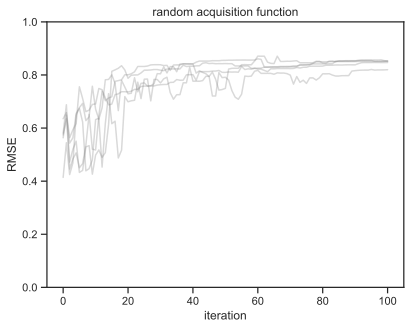

In [144]:
gt_var = np.load('/Users/drs18/Documents/multimodal-dev/23-11-13_SAS_var_2000_iter_matern52.npy').sum(1)
gt_var_norm = gt_var/gt_var.sum()

pseudoUCB_λ_1 = []
fig,ax = plt.subplots()
for ddx, dtag in enumerate(table['data_tag'].unique()):
    print(ddx)
    current_run = table.loc[table['data_tag'] == dtag]
    phasemap_list = []
    for uuid in list(current_run['uuid']):
        phasemap_list.append(glob.glob(f'/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/phasemap*{uuid}.nc')[0])
    
    LR_pm_norm = []
    LR_pm =[]
    #end
    for idx, path in enumerate(phasemap_list):
        ds_mani = xr.load_dataset(path)
        q = ds_mani.q

        # pull in the current iteration pm variance and normalize it to the total variance
        iter_pm_var = ds_mani.gp_classifier_y_var.sum(axis=1)
        iter_pm_var_norm = iter_pm_var/iter_pm_var.sum()

        # RMSE of standardized map
        RMSE_std = np.sqrt(sum((gt_var_norm - iter_pm_var_norm)**2)/gt_var_norm.size).values

        RMSE = np.sqrt(sum((gt_var - iter_pm_var)**2)/gt_var.size).values
        LR_pm.append(RMSE)
        LR_pm_norm.append(RMSE_std)
    
    ax.plot(1-np.array(LR_pm),c='gray',alpha=0.3,label='dtag')
    pseudoUCB_λ_1.append(1-np.array(LR_pm))
    
# ds = xr.Dataset(
#     dims={'campaign_number','iteration'},
#     data_vars = {('campaign_number','iteration'),})
# ax.plot(np.average(np.array(pseudoUCB_λ_1),axi=0),c='k',label='mean LR')
ax.set(
    xlabel='iteration',
    ylabel='RMSE',
    title='random acquisition function',
    ylim=(0,1)
)
# plt.savefig('/Users/drs18/Desktop/LR_pUCB_test.png',dpi=300)

In [235]:
def boolean_indexing(v, fillval=np.nan):
    lens = np.array([len(item) for item in v])
    mask = lens[:,None] > np.arange(lens.max())
    out = np.full(mask.shape,fillval)
    out[mask] = np.concatenate(v)
    return out

pseudoUCB_aggt = boolean_indexing(pseudoUCB_λ_1).T
pucb_xr = xr.DataArray(pseudoUCB_aggt,dims=('iteration','run'))


(101, 7)

[Text(0.5, 0, 'iteration'),
 Text(0, 0.5, 'RMSE'),
 Text(0.5, 1.0, 'GPC σ$^{2}$'),
 None]

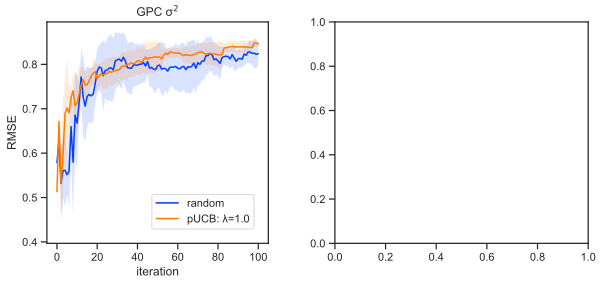

In [251]:
# rnd_acq = np.array(pseudoUCB_λ_1).T

mean_rnd = np.mean(rnd_acq,1)
std_rnd = np.std(rnd_acq,1)
iteration = np.arange(rnd_acq.shape[0])
fig,ax = plt.subplots(1,2,figsize=(10,4))
ax[0].plot(iteration, mean_rnd, label='random')
ax[0].fill_between(iteration,mean_rnd + std_rnd, mean_rnd - std_rnd, alpha=0.15)
ax[0].plot(pucb_xr.mean(dim='run'), label='pUCB: λ=1.0')
ax[0].fill_between(np.arange(pucb_xr.shape[0]),
                pucb_xr.mean(dim='run') + pucb_xr.std(dim='run'),
                pucb_xr.mean(dim='run') - pucb_xr.std(dim='run'),
                alpha=0.15)
ax[0].legend(bbox_to_anchor=(0.96,0.04),loc='lower right')
ax[0].set(
    xlabel='iteration',
    ylabel='RMSE',
    title='GPC σ$^{2}$',
    box_aspect=1
)
# ax[0].set_aspect('square')

### AL scattering Figs

In [75]:
# gt variance from exhaustive sampling that is standardized to the total variance
gt_var = np.load('/Users/drs18/Documents/multimodal-dev/23-11-13_SAS_var_2000_iter_matern52.npy').sum(1)
gt_var_norm = gt_var/gt_var.sum()

LR_pm_norm = []
LR_pm =[]
#end
for jdx, path in enumerate(phasemap_list):
    ds_mani = xr.load_dataset(path)
    q = ds_mani.q
    
    # pull in the current iteration pm variance and normalize it to the total variance
    iter_pm_var = ds_mani.gp_classifier_y_var.sum(axis=1)
    iter_pm_var_norm = iter_pm_var/iter_pm_var.sum()
    
    # RMSE of standardized map
    RMSE_std = np.sqrt(sum((gt_var_norm - iter_pm_var_norm)**2)/gt_var_norm.size).values
    
    RMSE = np.sqrt(sum((gt_var - iter_pm_var)**2)/gt_var.size).values
    LR_pm.append(RMSE)
    LR_pm_norm.append(RMSE_std)
    
    #scattering + 
    fig,ax = plt.subplots(1,2,figsize=(8,4),constrained_layout=True)
    for idx,label in enumerate(np.unique(ds_mani.labels)):
        x = ds_mani.benzyl_alcohol_solute.where(ds_mani.labels==label)
        y = ds_mani.phenol_solute.where(ds_mani.labels==label)
        I = ds_mani.SAS.where(ds_mani.labels==label)
        # print(I.shape)
        label_sp = ax[0].scatter(x=x,y=y,c=f'C{idx}');
        for i in I:
            label_SAS = ax[1].plot(q, i,c=f'C{idx}',alpha=0.3);
    ax[0].set(
        xlabel='benzyl alcohol [mg/ml]',
        ylabel='phenol [mg/ml]',
        title='solution space',
        xlim = (0,15),
        ylim = (0,15)
    )
    # ax[0].set_aspect('equal')

    ax[1].set(
        xlabel='q in nm$^{-1}$',
        ylabel='intensity [a.u.]',
        title='SANS data',
        xscale='log',
        yscale='log',
        ylim=(1e1,1e4)
    )
    # ax[1].set_aspect('equal')
    
    plt.savefig(f"/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/output_figs/Scattering_figs/multi-modal_random_acq_trial_01_iteration_{str(jdx).zfill(3)}.png",dpi=300)
    plt.savefig(f"/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/output_figs/Scattering_figs/multi-modal_random_acq_trial_01_iteration_{str(jdx).zfill(3)}.svg",dpi=300)
    plt.close(fig)

### AL GP model figs

In [76]:
for jdx, path in enumerate(phasemap_list):
    ds_mani = xr.load_dataset(path)
    q = ds_mani.q
    
    # pull in the current iteration pm variance and normalize it to the total variance
    iter_pm_var = ds_mani.gp_classifier_y_var.sum(axis=1)
    iter_pm_var_norm = iter_pm_var/iter_pm_var.sum()
    
    # RMSE of standardized map
    RMSE_std = np.sqrt(sum((gt_var_norm - iter_pm_var_norm)**2)/gt_var_norm.size).values
    
    RMSE = np.sqrt(sum((gt_var - iter_pm_var)**2)/gt_var.size).values
    LR_pm.append(RMSE)
    LR_pm_norm.append(RMSE_std)
    
    #GPC and GPR
    fig,ax = plt.subplots(1,3,figsize=(18,4),constrained_layout=False)
    
    ## gp classifier and regressor contributions
    x = ds_mani.benzyl_alcohol_solute_grid
    y = ds_mani.phenol_solute_grid
    z = ds_mani.gp_classifier_y_var.sum(axis=1)
    print(f'total variance: {np.round(z.sum().values)}')
    idx = np.argmax(z.values)
    gp_class_var = ax[0].scatter(x,y,c=z);
    scale_bar = plt.colorbar(gp_class_var,ax=ax[0])

    z = ds_mani.gp_regressor_y_mean
    idx = np.argmax(z.values)
    gp_regress_mu = ax[1].scatter(x,y,c=z);
    scale_bar = plt.colorbar(gp_regress_mu,ax=ax[1])
    
    z = ds_mani.acq_metric
    idx = np.argmax(z.values)
    acq_func = ax[2].scatter(x,y,c=z);
    scale_bar = plt.colorbar(acq_func,ax=ax[2])
    

    #plot the location of the next sample
    ax[0].scatter(x.values[idx],y.values[idx], 75,c='lightgreen',marker='x',label='next sample');
    ax[1].scatter(x.values[idx],y.values[idx], 75,c='lightgreen',marker='x',label='next sample');
    ax[2].scatter(x.values[idx],y.values[idx], 75,c='lightgreen',marker='x',label='next sample');
    ax[0].set(
        xlabel='benzyl alcohol [mg/ml]',
        ylabel='phenol [mg/ml]',
        title='GP classifier σ$^{2}$',
        xlim = (0,15),
        ylim = (0,15)
    )

    ax[1].set(
        xlabel='benzyl alcohol [mg/ml]',
        ylabel='phenol [mg/ml]',
        title='GP regressor μ',
        xlim = (0,15),
        ylim = (0,15)
    )

    ax[2].set(
        xlabel='benzyl alcohol [mg/ml]',
        ylabel='phenol [mg/ml]',
        title='UCB acquisition function',
        xlim = (0,15),
        ylim = (0,15)
    )
    plt.savefig(f"/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/output_figs/GP_models/multi-modal_random_acq_trial_01_iteration_{str(jdx).zfill(3)}.png",dpi=300)
    plt.savefig(f"/Users/drs18/Documents/multimodal-dev/231125_VirtualAL_pEI/output_figs/GP_models/multi-modal_random_acq_trial_01_iteration_{str(jdx).zfill(3)}.svg",dpi=300)
    
    plt.close(fig)

total variance: 936.0
total variance: 733.0
total variance: 913.0
total variance: 831.0
total variance: 484.0
total variance: 423.0
total variance: 415.0
total variance: 492.0
total variance: 465.0
total variance: 298.0
total variance: 409.0
total variance: 465.0
total variance: 395.0
total variance: 237.0
total variance: 234.0
total variance: 214.0
total variance: 265.0
total variance: 414.0
total variance: 237.0
total variance: 284.0
total variance: 323.0
total variance: 319.0
total variance: 234.0
total variance: 308.0
total variance: 262.0
total variance: 255.0
total variance: 268.0
total variance: 266.0
total variance: 256.0
total variance: 192.0
total variance: 193.0
total variance: 155.0
total variance: 188.0
total variance: 151.0
total variance: 152.0
total variance: 175.0
total variance: 138.0
total variance: 136.0
total variance: 136.0
total variance: 137.0
total variance: 136.0
total variance: 193.0
total variance: 177.0
total variance: 183.0
total variance: 188.0
total vari

### Turbidity solution space

In [229]:
# gt variance from exhaustive sampling that is standardized to the total variance
gt_var = np.load('/Users/drs18/Documents/multimodal-dev/23-11-13_SAS_var_2000_iter_matern52.npy').sum(1)
gt_var_norm = gt_var/gt_var.sum()

LR_pm_norm = []
LR_pm =[]
#end
for jdx, path in enumerate(phasemap_list):
    ds_mani = xr.load_dataset(path)
    q = ds_mani.q
    
    # pull in the current iteration pm variance and normalize it to the total variance
    iter_pm_var = ds_mani.gp_classifier_y_var.sum(axis=1)
    iter_pm_var_norm = iter_pm_var/iter_pm_var.sum()
    
    # RMSE of standardized map
    RMSE_std = np.sqrt(sum((gt_var_norm - iter_pm_var_norm)**2)/gt_var_norm.size).values
    
    RMSE = np.sqrt(sum((gt_var - iter_pm_var)**2)/gt_var.size).values
    LR_pm.append(RMSE)
    LR_pm_norm.append(RMSE_std)
    
    #turbidity
    fig,ax = plt.subplots()
    sp = ax.scatter(ds_mani.benzyl_alcohol_solute,ds_mani.phenol_solute,c=ds_mani.turbidity);
    cb = plt.colorbar(sp,ax=ax)
    ax.set(
        xlabel='benzyl alcohol [mg/ml]',
        ylabel='phenol [mg/ml]',
        title='turbidity',
        xlim = (0,15),
        ylim = (0,15)
    )
    
    plt.savefig(f"/Users/drs18/Documents/multimodal-dev/231124/output_figs/multi-modal_random_acq_trial_01_iteration_{str(jdx).zfill(3)}.png",dpi=300)
    plt.savefig(f"/Users/drs18/Documents/multimodal-dev/231124/output_figs/multi-modal_random_acq_trial_01_iteration_{str(jdx).zfill(3)}.svg",dpi=300)
    plt.close(fig)

### convert to gifs

In [287]:
import imageio.v2 as imageio
import glob
images = []
filenames = list(sorted(glob.glob('/Users/drs18/Documents/multimodal-dev/231121_PSI_retake/output_figs/Scattering_figs/multi-modal_PSI_run_λ_1_noThompson_iteration_*.png')))
for filename in filenames:
    images.append(imageio.imread(filename))
imageio.mimsave('/Users/drs18/Documents/multimodal-dev/231121_PSI_retake/output_figs/Scattering_noThompson.gif', images, duration=0.5)

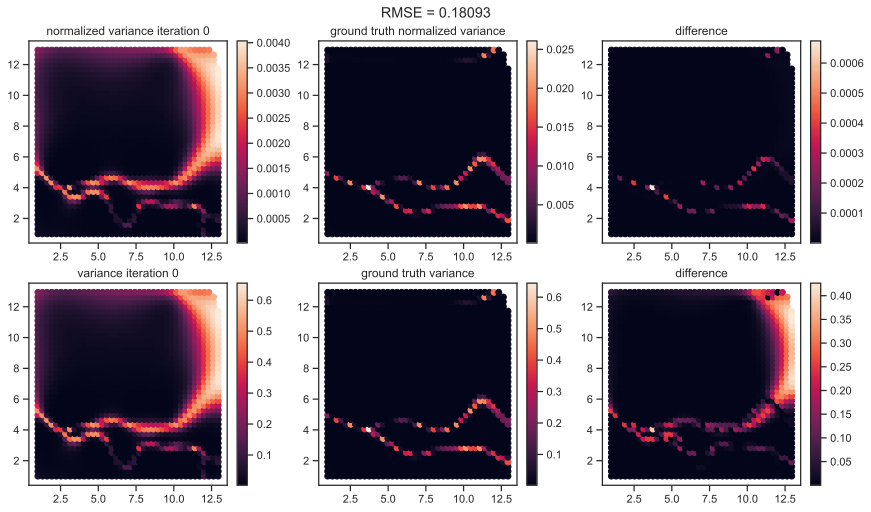

(96, 444)
(96, 444)
(96, 444)
(96, 444)
(96, 444)
total variance: <xarray.DataArray 'gp_classifier_y_var' ()>
162.0


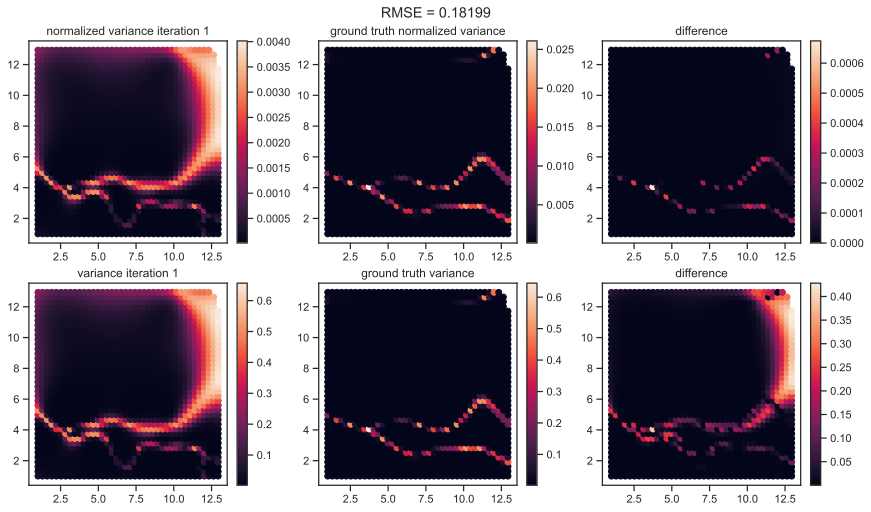

(97, 444)
(97, 444)
(97, 444)
(97, 444)
(97, 444)
total variance: <xarray.DataArray 'gp_classifier_y_var' ()>
164.0


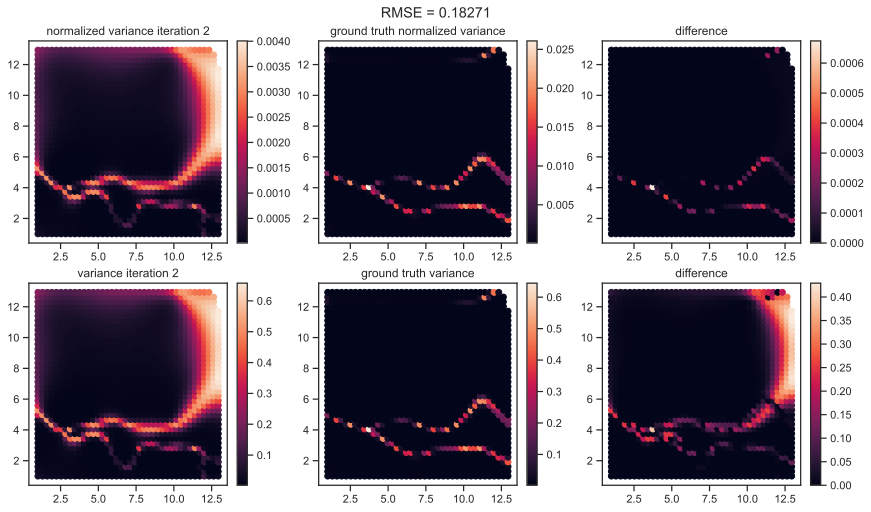

(98, 444)
(98, 444)
(98, 444)
(98, 444)
(98, 444)
total variance: <xarray.DataArray 'gp_classifier_y_var' ()>
164.0


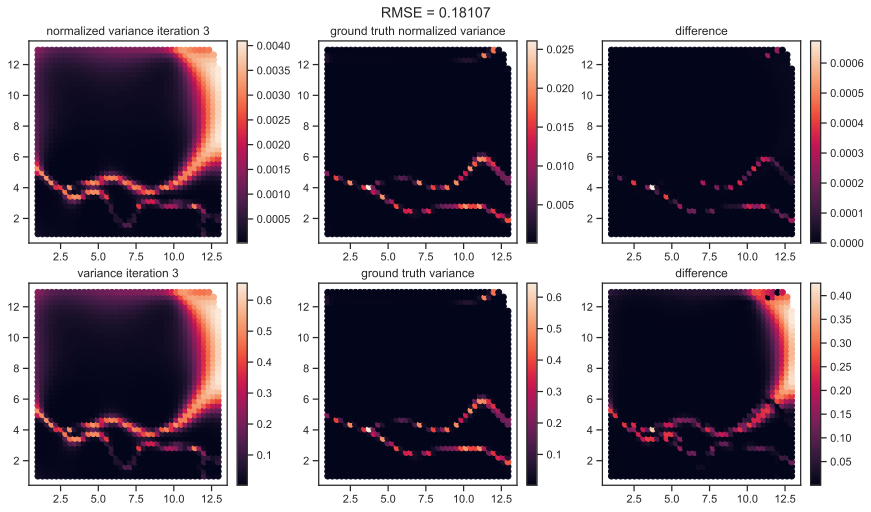

(99, 444)
(99, 444)
(99, 444)
(99, 444)
(99, 444)
total variance: <xarray.DataArray 'gp_classifier_y_var' ()>
160.0


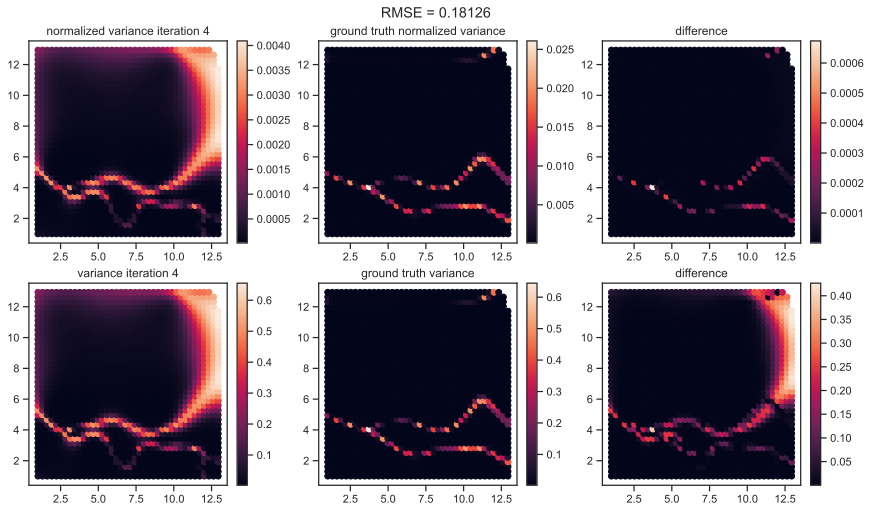

(100, 444)
(100, 444)
(100, 444)
(100, 444)
(100, 444)
total variance: <xarray.DataArray 'gp_classifier_y_var' ()>
160.0


In [174]:
# gt variance from exhaustive sampling that is standardized to the total variance
gt_var = np.load('/Users/drs18/Documents/multimodal-dev/23-11-13_SAS_var_2000_iter_matern52.npy').sum(1)
gt_var_norm = gt_var/gt_var.sum()

LR_pm_norm = []
LR_pm =[]
#end
for idx, path in enumerate(phasemap_list[-5:]):
    # AL_manifest_path = '/Users/drs18/Documents/multimodal-dev/VirtualAL/phasemap_Virtual_AL_multi-modal_test_13-13-10_UCB_lambda-1.25_fcf6a87c-e899-4acf-bebe-87ddb861b76a.nc'

    # gt_path = '/Users/drs18/Documents/multimodal-dev/VirtualAL/phasemap_Virtual_AL_test_514dc7a4-ba9f-4842-aed1-d9e7ebc03e75.nc'
    # ds_AL = xr.load_dataset(AL_run_path)
    ds_mani = xr.load_dataset(path)
    # ds_gt = xr.load_dataset(gt_path)
    # ds_gt.attrs["SAS_savgol_xlo"] = 0.01
    # ds_gt.attrs["SAS_savgol_xhi"] = 0.25
    q = ds_mani.q
    
    # pull in the current iteration pm variance and normalize it to the total variance
    iter_pm_var = ds_mani.gp_classifier_y_var.sum(axis=1)
    iter_pm_var_norm = iter_pm_var/iter_pm_var.sum()
    
    # RMSE of standardized map
    RMSE_std = np.sqrt(sum((gt_var_norm - iter_pm_var_norm)**2)/gt_var_norm.size).values
    
    RMSE = np.sqrt(sum((gt_var - iter_pm_var)**2)/gt_var.size).values
    LR_pm.append(RMSE)
    LR_pm_norm.append(RMSE_std)
    
    fig,ax = plt.subplots(2,3,figsize=(12,7),constrained_layout=True)
    fig.suptitle(f'RMSE = {np.round(RMSE,5)}')
    x = ds_mani.benzyl_alcohol_solute_grid
    y = ds_mani.phenol_solute_grid
    sp = ax[0][0].scatter(x,y,c=iter_pm_var_norm)
    plt.colorbar(sp, ax=ax[0][0])
    sp = ax[0][1].scatter(x,y,c=gt_var_norm)
    plt.colorbar(sp, ax=ax[0][1])
    sp = ax[0][2].scatter(x,y,c=abs(gt_var_norm - iter_pm_var_norm)**2)
    plt.colorbar(sp, ax=ax[0][2])
    sp = ax[1][0].scatter(x,y,c=iter_pm_var)
    plt.colorbar(sp, ax=ax[1][0])
    sp = ax[1][1].scatter(x,y,c=gt_var)
    plt.colorbar(sp, ax=ax[1][1])
    sp = ax[1][2].scatter(x,y,c=abs(gt_var - iter_pm_var)**2)
    plt.colorbar(sp, ax=ax[1][2])
    
    ax[0][0].set(
        title=f"normalized variance iteration {idx}"
    )
    ax[0][1].set(
        title=f"ground truth normalized variance"
    )
    ax[0][2].set(
        title=f'difference'
    )
    
    ax[1][0].set(
        title=f"variance iteration {idx}"
    )
    ax[1][1].set(
        title=f"ground truth variance"
    )
    ax[1][2].set(
        title=f'difference'
    )
    
    plt.show(fig)
    plt.close(fig)


    #sampled data input
    fig,ax = plt.subplots(3,3,dpi=100,figsize=(15,11),constrained_layout=True)
    for idx,label in enumerate(np.unique(ds_mani.labels)):
        x = ds_mani.benzyl_alcohol_solute.where(ds_mani.labels==label)
        y = ds_mani.phenol_solute.where(ds_mani.labels==label)
        I = ds_mani.SAS.where(ds_mani.labels==label)
        print(I.shape)
        label_sp = ax[0][0].scatter(x=x,y=y,c=f'C{idx}')
        for i in I:
            label_SAS = ax[0][2].plot(q, i,c=f'C{idx}',alpha=0.3)

    ax[0][1].scatter(ds_mani.benzyl_alcohol_solute,ds_mani.phenol_solute,c=ds_mani.turbidity)
    ## gp classifier and regressor contributions
    x = ds_mani.benzyl_alcohol_solute_grid
    y = ds_mani.phenol_solute_grid
    z = ds_mani.gp_classifier_y_var.sum(axis=1)
    print(f'total variance: {np.round(np.sum(z))}')
    idx = np.argmax(z.values)
    gp_class_var = ax[1][0].scatter(x,y,c=z)
    scale_bar = plt.colorbar(gp_class_var,ax=ax[1][0])
    
    z = ds_mani.gp_classifier_y_mean.sum(axis=1)
    gp_class_mean = ax[1][1].scatter(x,y,c=z)
    scale_bar = plt.colorbar(gp_class_mean,ax=ax[1][1])
    
    z = ds_mani.gp_regressor_y_var
    gp_class_mean = ax[2][1].scatter(x,y,c=z)
    scale_bar = plt.colorbar(gp_class_mean,ax=ax[2][1])

    z = ds_mani.gp_regressor_y_mean
    idx = np.argmax(z.values)
    gp_regress_mu = ax[2][0].scatter(x,y,c=z)
    scale_bar = plt.colorbar(gp_regress_mu,ax=ax[2][0])

    z = ds_mani.gp_regressor_y_var/(ds_mani.gp_regressor_y_mean)
    gpr_perc_var = ax[2][2].scatter(x,y,c=z,clim=(0.0,2.))
    scale_bar = plt.colorbar(gpr_perc_var, ax=ax[2][2])
    
    z = ds_mani.acq_metric
    idx = np.argmax(z.values)
    acq_func = ax[1][2].scatter(x,y,c=z)
    scale_bar = plt.colorbar(acq_func,ax=ax[1][2])

    #plot the location of the next sample
    ax[1][0].scatter(x.values[idx],y.values[idx], 75,c='lightgreen',marker='x',label='next sample')
    ax[1][1].scatter(x.values[idx],y.values[idx], 75,c='lightgreen',marker='x',label='next sample')
    ax[1][2].scatter(x.values[idx],y.values[idx], 75,c='lightgreen',marker='x',label='next sample')


    ax[0][0].set(
        xlabel='benzyl alcohol [mg/ml]',
        ylabel='phenol [mg/ml]',
        title='labeled solution space',
        xlim = (0,15),
        ylim = (0,15)
    )

    ax[0][1].set(
        xlabel='benzyl alcohol [mg/ml]',
        ylabel='phenol [mg/ml]',
        title='Turbidity value',
        xlim = (0,15),
        ylim = (0,15)
    )

    ax[0][2].set(
        xlabel='q in nm$^{-1}$',
        ylabel='intensity [a.u.]',
        title='scattering data',
        xscale='log',
        yscale='log',
        ylim=(1e1,1e4)
    )

    ax[1][0].set(
        xlabel='benzyl alcohol [mg/ml]',
        ylabel='phenol [mg/ml]',
        title='GP classifier σ$^{2}$',
        xlim = (0,15),
        ylim = (0,15)
    )

    ax[1][1].set(
        xlabel='benzyl alcohol [mg/ml]',
        ylabel='phenol [mg/ml]',
        title='GP regressor μ',
        xlim = (0,15),
        ylim = (0,15)
    )

    ax[1][2].set(
        xlabel='benzyl alcohol [mg/ml]',
        ylabel='phenol [mg/ml]',
        title='UCB acquisition function',
        xlim = (0,15),
        ylim = (0,15)
    )
    plt.show(fig)
    plt.close(fig)
    
# plt.savefig("/Users/drs18/Desktop/multi-modal_simulation_λ_1.25.png",dpi=300)
# plt.savefig("/Users/drs18/Desktop/multi-modal_simulation_λ_1.25.svg",dpi=300)

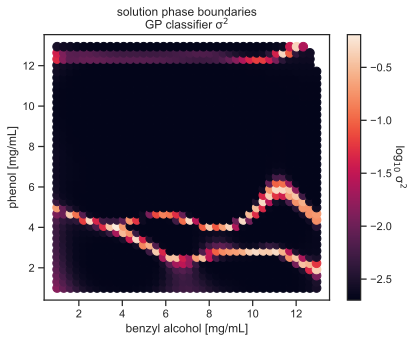

In [81]:
# #ground truth plot stand alone
# fig,ax = plt.subplots()
# sp = ax.scatter(x,y,s=75,c=np.log10(gt_var))
# cb = plt.colorbar(sp,ax=ax)
# ax.set(
#     xlabel='benzyl alcohol [mg/mL]',
#     ylabel='phenol [mg/mL]',
#     title= 'solution phase boundaries\nGP classifier σ$^{2}$'
# )
# cb.set_label('log$_{10}$ σ$^{2}$',rotation=270,labelpad=15)

# plt.savefig('/Users/drs18/Documents/Presentations/2023_Fall-MRS/P188_GT_phase_boundaries.png',dpi=300)
# plt.savefig('/Users/drs18/Documents/Presentations/2023_Fall-MRS/P188_GT_phase_boundaries.svg',dpi=300)


# turb_gt = np.load()
fig,ax = plt.subplots()
sp = ax.scatter(x,y,s=75,c=np.log10(gt_var))
cb = plt.colorbar(sp,ax=ax)
ax.set(
    xlabel='benzyl alcohol [mg/mL]',
    ylabel='phenol [mg/mL]',
    title= 'solution phase boundaries\nGP classifier σ$^{2}$'
)
cb.set_label('log$_{10}$ σ$^{2}$',rotation=270,labelpad=15)

# plt.savefig('/Users/drs18/Documents/Presentations/2023_Fall-MRS/P188_GT_phase_boundaries.png',dpi=300)
# plt.savefig('/Users/drs18/Documents/Presentations/2023_Fall-MRS/P188_GT_phase_boundaries.svg',dpi=300)

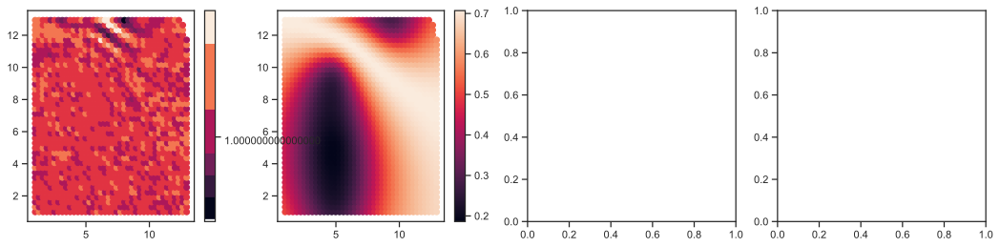

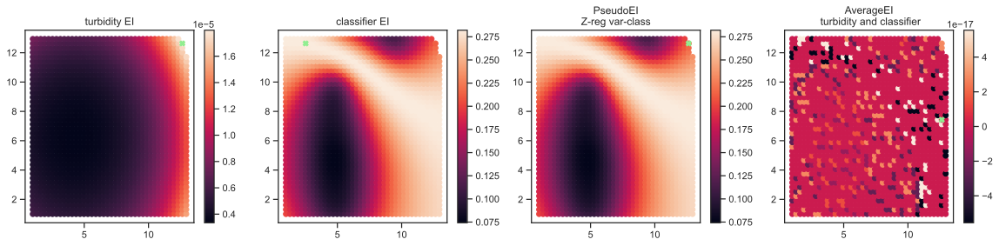

In [190]:
#regressor
gpr_y_mu = ds_mani.gp_regressor_y_mean
gpr_y_sig = np.sqrt(ds_mani.gp_regressor_y_var)

#classifier
gpc_y_mu = ds_mani.gp_classifier_y_mean.sum(dim='phase_num')
gpc_y_sig = np.sqrt(ds_mani.gp_classifier_y_var.sum(dim='phase_num'))
fig,ax = plt.subplots(1,4,figsize=(18,4))
sp = ax[0].scatter(x,y,c=gpc_y_mu)#ds_mani.gp_classifier_y_mean.values[:,0])
plt.colorbar(sp,ax=ax[0])

sp = ax[1].scatter(x,y,c=gpc_y_sig)#ds_mani.gp_classifier_y_var.values[:,0])
plt.colorbar(sp,ax=ax[1])

#turbidity EI
fmax = ds_mani.turbidity.max()
fmax = (fmax - ds_mani.turbidity.mean())/ds_mani.turbidity.std()    #standardized because the data in the GP model is standardized
Z = (gpr_y_mu - fmax)/gpr_y_sig
cdf = norm.cdf(Z)
pdf = norm.pdf(Z)
acq_fxn_turb = gpr_y_sig*(pdf + Z*cdf)

# # classification EI
# fmax = ds_mani.gp_classifier_y_mean.sum(dim='phase_num').max()
# Z = (gpc_y_mu - fmax)/gpc_y_sig
# cdf = norm.cdf(Z)
# pdf = norm.pdf(Z)
# acq_fxn_class = gpc_y_sig*(pdf + Z*cdf)
# acq_fxn_class_1 = gpc_y_sig*pdf + (gpc_y_mu-fmax)*cdf
# sp = ax[2].scatter(x,y,c=Z)
# plt.colorbar(sp,ax=ax[2])
# ax[3].scatter(x,y,c=cdf)

# # pseudo EI
# fmax = ds_mani.gp_classifier_y_mean.sum(dim='phase_num').max()
# Z = (gpr_y_mu - fmax)/gpr_y_sig
# cdf = norm.cdf(Z)
# pdf = norm.pdf(Z)
# acq_fxn_pseudoEI = gpc_y_sig*(pdf + Z*cdf)
# acq_fxn_pseudoEI = gpr_y_sig*pdf + (gpr_y_mu-fmax)*cdf

# # additive EI
# acq_fxn_additive = (acq_fxn_turb + acq_fxn_class)


fig,ax = plt.subplots(1,4,figsize=(20,4))
x = ds_mani.benzyl_alcohol_solute_grid.values
y = ds_mani.phenol_solute_grid.values
sp=ax[0].scatter(x=x, y=y, c=acq_fxn_turb)
ax[0].set_title("turbidity EI")
next_idx = np.argmax(acq_fxn_turb.values)
ax[0].scatter(x[next_idx],y[next_idx],c='lightgreen',marker='X')
plt.colorbar(sp,ax=ax[0])

sp=ax[1].scatter(x=x, y=y, c=acq_fxn_class)
ax[1].set_title("classifier EI")
next_idx = np.argmax(acq_fxn_class.values)
ax[1].scatter(x[next_idx],y[next_idx],c='lightgreen',marker='X')
plt.colorbar(sp,ax=ax[1])

# sp=ax[2].scatter(x=x, y=y, c=acq_fxn_pseudoEI)
sp=ax[2].scatter(x=x, y=y, c=acq_fxn_class_1)
ax[2].set_title("PseudoEI\nZ-reg var-class")
next_idx = np.argmax(acq_fxn_pseudoEI.values)
ax[2].scatter(x[next_idx],y[next_idx],c='lightgreen',marker='X')
plt.colorbar(sp,ax=ax[2])

sp=ax[3].scatter(x=x, y=y, c=acq_fxn_class-acq_fxn_class_1)
ax[3].set_title("AverageEI\n turbidity and classifier")
next_idx = np.argmax(acq_fxn_additive.values)
ax[3].scatter(x[next_idx],y[next_idx],c='lightgreen',marker='X')
plt.colorbar(sp,ax=ax[3])

## ground truth of the scattering data

In [103]:
from tiled.client import from_uri
from tiled.queries import Eq
tc = from_uri('http://localhost:8000',api_key='NistoRoboto642')

scattering_data = []
turbidity_data = []

for idx,(x,y,z) in enumerate(zip(ds_mani.P188_grid.values, ds_mani.benzyl_alcohol_solute_grid.values, ds_mani.phenol_solute_grid.values)):
    print(idx)
    new_data = {
        'sample_composition':{
            'P188':{
                'values':[x],
                'units':'mg/ml'
            },
            'benzyl_alcohol_solute':{
                'values':[y],
                'units': 'mg/ml'
            },
            'phenol_solute':{
                'values':[z],
                'units': 'mg/ml'
            },
        }
    }
    sas_client.enqueue(task_name='set_sample',sample_name='test',**new_data)
    sas_client.enqueue(task_name='expose')
    
    query = tc.search(Eq('task_name','expose'))
    key, value = query.items()[-1]
    # print(key, value)
    # print(np.array(value))
    scattering_data.append(np.array(value))
    
    turb_client.enqueue(task_name='set_sample',sample_name='test',**new_data)
    turb_client.enqueue(task_name='measure')
    query = tc.search(Eq('task_name','measure'))
    key, value = query.items()[-1]
    turbidity_data.append(np.array(value))
    

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [140]:
turbidity_data = xr.load_dataset('23-11-13_scattering_Data_GT.nc')['turbidity_gt'].values
# print(turbidity_data)
x,y = ds_mani.benzyl_alcohol_solute_grid.values[::15], ds_mani.phenol_solute_grid[::15]
xnorm = (x - x.min())/(x.max() - x.min())
ynorm = (y - y.min())/(y.max() - y.min())
z = turbidity_data[::15]
# z = (z-min(z))/(max(z)-min(z))
z = (z- np.mean(z))/np.std(z)
# X = np.vstack((x,y,)).T
X = np.vstack((xnorm,ynorm,)).T
Y = np.expand_dims(z,axis=-1)

turb_model = gpflow.models.GPR(
    data=(X,Y),
    kernel=gpflow.kernels.Matern52(lengthscales=0.2,variance=1.0),
)
optimizer = tf.optimizers.legacy.Adam(learning_rate=0.05)

#optimize
HPs = []
for i in np.arange(2):
    # print(i)
    optimizer.minimize(turb_model.training_loss, turb_model.trainable_variables)
    HPs.append([i.numpy() for i in turb_model.parameters])

y_predict = turb_model.predict_y(Xnew=np.array(list(zip(x,y))))
# plt.plot(HPs)


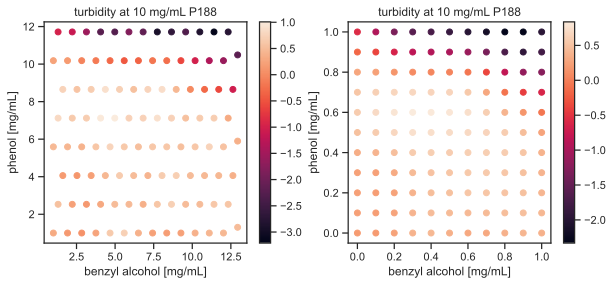

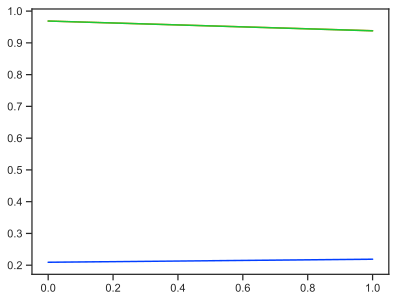

In [148]:
X_new = np.meshgrid(np.linspace(0,1,11),np.linspace(0,1,11))
X_new = np.array(list(zip(X_new[0].ravel(),X_new[1].ravel())))
# y_predict = turb_model.predict_f(Xnew=np.array(list(zip(xnorm,ynorm))))
y_predict = turb_model.predict_f(Xnew=X_new)

fig,ax = plt.subplots(1,2,figsize=(10,4))
sp = ax[0].scatter(x,y,c=np.array(z))
plt.colorbar(sp,ax=ax[0])
ax[0].set(
    xlabel='benzyl alcohol [mg/mL]',
    ylabel='phenol [mg/mL]',
    title='turbidity at 10 mg/mL P188'
)
# from scipy.ndimage import gaussian_filter
sp = ax[1].scatter(X_new[:,0],X_new[:,1],c=y_predict[0].numpy())
plt.colorbar(sp,ax=ax[1])
ax[1].set(
    xlabel='benzyl alcohol [mg/mL]',
    ylabel='phenol [mg/mL]',
    title='turbidity at 10 mg/mL P188'
)
fig,ax = plt.subplots()
ax.plot(HPs)

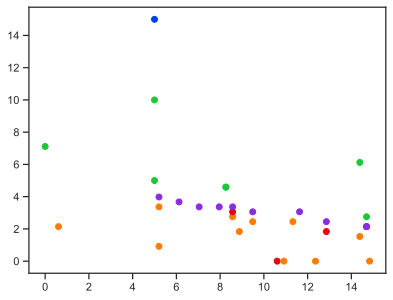

In [123]:
SAS_server_ds = sas_client.get_driver_object('dataset')
fig,ax = plt.subplots()
ax.scatter(SAS_server_ds.benzyl_alcohol_solute.values,SAS_server_ds.phenol_solute.values,c=[f'C{i}' for i in SAS_server_ds.labels.values])

In [118]:
model_ds

<xarray.Dataset>
Dimensions:                      (sample: 33, q: 500, wavelength: 2048,
                                  logq: 250, grid: 2297, sample_i: 33,
                                  sample_j: 33, phase_num: 5, component: 3)
Coordinates:
  * q                            (q) float64 0.009814 0.01036 ... 0.2791 0.2796
  * wavelength                   (wavelength) float64 180.8 181.2 ... 867.9
  * logq                         (logq) float64 -1.985 -1.975 ... -0.6022
  * component                    (component) object 'P188' ... 'phenol_solute'
Dimensions without coordinates: sample, grid, sample_i, sample_j, phase_num
Data variables: (12/36)
    fname                        (sample) object 'AL_P188_2D_MultiModal_UCB_n...
    SAS                          (sample, q) float64 679.3 676.8 ... 40.92 40.92
    turbidity                    (sample) float64 -0.9926 -0.9915 ... -0.9888
    spec                         (sample, wavelength) float64 0.0 96.0 ... 116.0
    spec_error                   (sample, wavelength) float64 0.0 1.0 ... 3.0
    label                        (sample) int64 -1 -1 -1 -1 -1 ... -1 -1 -1 -1
    ...                           ...
    acq_metric                   (grid) float64 0.508 0.4681 ... 1.292 1.377
    gp_classifier_y_var          (grid, phase_num) float64 0.009735 ... 0.09713
    gp_classifier_y_mean         (grid, phase_num) float64 0.009832 ... 0.109
    gp_regressor_y_mean          (grid) float64 0.2098 0.2148 ... -0.5811
    gp_regressor_y_var           (grid) float64 0.3886 0.3737 ... 0.6814 0.6931
    next_sample                  (component) float64 10.0 4.286 4.286
Attributes: (12/40)
    components:                        ['P188', 'benzyl_alcohol_solute', 'phe...
    P188_range:                        [10.  10.1]
    benzyl_alcohol_solute_range:       [ 0 15]
    phenol_solute_range:               [ 0 15]
    P188_npts:                         1
    benzyl_alcohol_solute_npts:        50
    ...                                ...
    uuid:                              30524b88-00f7-4606-9c4d-57ad7880f95e
    date:                              230530
    time:                              09:05:33
    data_tag:                          P188_2D_MultiModal_UCB_noThomp_FixedP188
    acq_count:                         1
    iteration:                         31

### store the GT data

In [35]:
import gpflow
import tensorflow as tf

kernel = gpflow.kernels.Matern52(lengthscales=1.0, variance=1.)
optimizer = 
# Turbidity_Model = gpflow.models.GPR()

In [130]:
da = xr.Dataset(data_vars={'turbidity_gt':(('grid'),np.array(turbidity_data)),
                          'scattering_gt':(('grid','q'),np.array(scattering_data)),
                          'benzyl_alcohol_solute_grid':('grid',ds_mani.benzyl_alcohol_solute_grid.values),
                          'phenol_solute_grid':('grid',ds_mani.phenol_solute_grid.values),
                          'P188_grid':('grid',ds_mani.P188_grid.values)},
               coords={'q':q.values},
               attrs=ds_mani.attrs)
da.to_netcdf('/Users/drs18/Documents/multimodal-dev/23-11-13_scattering_Data_GT.nc')

In [132]:
da

<xarray.Dataset>
Dimensions:                     (grid: 1595, q: 444)
Coordinates:
  * q                           (q) float64 0.01036 0.0109 ... 0.2494 0.2499
Dimensions without coordinates: grid
Data variables:
    turbidity_gt                (grid) float64 -1.069 -1.03 ... -1.887 -1.929
    scattering_gt               (grid, q) float64 138.5 137.7 ... 35.87 35.92
    benzyl_alcohol_solute_grid  (grid) float64 1.0 1.0 1.0 ... 12.94 12.94 12.94
    phenol_solute_grid          (grid) float64 1.0 1.306 1.612 ... 11.41 11.71
    P188_grid                   (grid) float64 10.0 10.0 10.0 ... 10.0 10.0 10.0
Attributes: (12/41)
    components:                        ['P188', 'benzyl_alcohol_solute', 'phe...
    P188_range:                        [10.  10.1]
    benzyl_alcohol_solute_range:       [ 1 16]
    phenol_solute_range:               [ 1 16]
    P188_npts:                         1
    benzyl_alcohol_solute_npts:        50
    ...                                ...
    sample_uuid:                       d573bca1-beda-437f-967a-6b7d1e7916f5
    date:                              231108
    time:                              10:43:34
    data_tag:                          Virtual_AL_multi-modal_test_13-13-10_U...
    acq_count:                         1
    iteration:                         37

# Tiled check

In [36]:
from tiled.client import from_uri
from tiled.queries import Eq
tiled_catalogue = from_uri('http://localhost:8000',api_key="NistoRoboto642")
query = tiled_catalogue.search(Eq('task_name','predict'))
print(query)
key, value = query.items()[-1]
# value.metadata

<Container {'f94bed17-ac95-4a1e-bc99-2b71f4e6bc6d', ...} ~1292 entries>


In [57]:
from tiled.client import from_uri
from tiled.queries import Eq
tiled_catalogue = from_uri('http://localhost:8000',api_key="NistoRoboto642")
fig,ax = plt.subplots(1,2)
test_points = np.array([[4.0,7.0,5.5,4.0],[9.0,14.0,4.,2.0]]).T
for ba, ph in test_points:#zip(ds_mani.benzyl_alcohol_solute.values[:5], ds_mani.phenol_solute.values[:5]):
    
    new_data = {
        'sample_composition':{
            'P188':{
                'values':[10.],
                'units':'mg/ml'
            },
            'benzyl_alcohol_solute':{
                'values':[ba],
                'units': 'mg/ml'
            },
            'phenol_solute':{
                'values':[ph],
                'units': 'mg/ml'
            },
        }
    }
    sas_client.enqueue(task_name='set_sample',sample_name='test',**new_data)
    sas_uuid = sas_client.enqueue(task_name='expose')
    ## based on sas_uuid
    query = tiled_catalogue.search(Eq('uuid', str(sas_uuid)))
    key, value = query.items()[-1]
    q_1 = np.array(value.metadata['q'])
    I_1 = np.array(value)
    print(min(I_1),max(I_1))
    
    query = tiled_catalogue.search(Eq('task_name', 'expose'))
    key, value = query.items()[-1]
    q_2 = np.array(value.metadata['q'])
    I_2 = np.array(value)
    print(min(I_2),max(I_2))
    print()
    ax[0].plot(q_1,I_1, label=f'ba: {np.round(ba, 1)} ph: {np.round(ph, 1)}')
    ax[1].plot(q_2,I_2, label=f'ba: {np.round(ba, 1)} ph: {np.round(ph, 1)}')
    
    
ax[0].set(
    xlabel='q in nm$^{-1}$',
    ylabel='intensity [a.u.]',
    title = 'seed points',
    xscale='log',
    yscale='log'
)
ax[0].legend()    

ax[1].set(
    xlabel='q in nm$^{-1}$',
    ylabel='intensity [a.u.]',
    title = 'seed points',
    xscale='log',
    yscale='log'
)
ax[1].legend()

(UUID('ee40d99c-3bbc-4b0c-9fce-b59fb7d640b8'),
 {'X_*': [[10.000000000000002], [0.9999999999999991], [5.897959183673469]],
 'block': True,
 'components': ['P188', 'benzyl_alcohol_solute', 'phenol_solute'],
 'driver_config': {'filename': 'AL_Virtual_AL_multi-modal_test_13-13-10_47f60730.h5',
                   'filepath': '/Users/drs18/Documents/multimodal-dev/VirtualAL/',
                   'save_path': '/Users/drs18/Documents/multimodal-dev/VirtualAL/'},
 'driver_name': 'VirtualSANS_data',
 'exposure': 1000000.0,
 'meta': {'ended': '10/23/23 14:41:16-559049 ',
          'exit_state': 'Success!',
          'queued': '10/23/23 14:41:16-528287',
          'return_val': 'None',
          'run_time_minutes': 0.0,
          'run_time_seconds': 0,
          'started': '10/23/23 14:41:16-529394 '},
 'name': 'AL_Virtual_AL_multi-modal_test_13-13-10_c2c11d59',
 'platform_serial': '',
 'q': [0.010355111541483964,
       0.010895834593608412,
       0.011436557645732856,
       0.0119772806978573

# Check Mass Balance Calc

In [645]:
MB

In [646]:
MB.stocks

[<Solution name:"stock_buffer" size:1>,
 <Solution name:"stock_Px" size:2>,
 <Solution name:"stock_Bz" size:2>,
 <Solution name:"stock_Ph" size:2>]

In [648]:
target = sample_client.get_driver_object('target')
target

<Solution name:"target" size:4>

In [649]:
target.mass_fraction

{'P188': 0.008923693316335822 <Unit('dimensionless')>,
 'benzyl_alcohol_solute': 0.0002731742851939538 <Unit('dimensionless')>,
 'phenol_solute': 0.0002731742851939538 <Unit('dimensionless')>,
 'D2O': 0.9905299581132762 <Unit('dimensionless')>}

In [650]:
MB.set_target(target,'1A1')

In [651]:
MB.balance_mass()

/Users/drs18/mambaforge/envs/afl/lib/python3.8/site-packages/numpy/lib/function_base.py:625: UnitStrippedWarning: The unit of the quantity is stripped when downcasting to ndarray.
  a = asarray(a, dtype=dtype, order=order)


In [652]:
MB.mass_transfers

{<Solution name:"stock_buffer" size:1>: ('2A1',
  0.9805231521148902 <Unit('gram')>),
 <Solution name:"stock_Px" size:2>: ('1A3',
  0.11794515219293986 <Unit('gram')>),
 <Solution name:"stock_Bz" size:2>: ('1A2',
  0.011417826777539011 <Unit('gram')>),
 <Solution name:"stock_Ph" size:2>: ('1A1',
  0.01072611381259036 <Unit('gram')>)}

In [664]:
from AFL.automation.prepare.Solution import Solution
target_check = Solution('target_check',components=[])
for stock,(stock_loc,mass) in MB.mass_transfers.items():
    if mass>1*units('ug'):#tolerance
        removed = stock.copy()
        removed.mass = mass
        
        print(removed.volume.to('ul'))

        ##if this is changed, make_protocol needs to be updated
        if (removed.volume>0) and (removed.volume<20*units('ul')):
            continue

        target_check = target_check + removed


#need to add empty components for equality check
for name,component in target:
    if not target_check.contains(name):
        c = component.copy()
        c._mass = 0.0*units('g')
        target_check = target_check + c

883.3541910944958 microliter
97.24788485850438 microliter
10.010544440143622 microliter
9.387379606856548 microliter


In [662]:
target_check.concentration

{'D2O': 1110.0 <Unit('milligram / milliliter')>,
 'P188': 10.000000000000002 <Unit('milligram / milliliter')>,
 'benzyl_alcohol_solute': 0.30612244897959184 <Unit('milligram / milliliter')>,
 'phenol_solute': 0.30612244897959195 <Unit('milligram / milliliter')>}